In [ ]:
import pandas as pd
import xml.etree.ElementTree as ET
import glob
import os

directory_path = 'est'
os.chdir(directory_path)

column_names = ['Image', 'Height', 'Width', 'Depth', 'Coin_1', 'Coin_2', 'Coin_3', 'Coin_4']
data_frame = pd.DataFrame(columns=column_names)

# Initialiser des listes vides pour stocker les informations sur les pièces
coin_names = []
coin_values = {}

# Itérer sur les fichiers XML dans le répertoire
for xml_file in glob.glob('*.xml'):
    if xml_file.endswith('.xml'):
        # Analyser le fichier XML
        tree = ET.parse(os.path.join(directory_path, xml_file))
        root = tree.getroot()

        # Extraire le nom du fichier d'annotation
        file_name = root.find('filename').text

        # Extraire les informations sur la taille
        width = int(root.find('size/width').text)
        height = int(root.find('size/height').text)
        depth = int(root.find('size/depth').text)

        # Itérer sur les éléments 'object'
        for obj in root.iter('object'):
            # Extraire le nom de la pièce
            coin_name = obj.find('name').text

            # Extraire la valeur de la pièce (xmin, ymin, xmax, ymax)
            bbox = obj.find('bndbox')
            xmin = int(bbox.find('xmin').text)
            ymin = int(bbox.find('ymin').text)
            xmax = int(bbox.find('xmax').text)
            ymax = int(bbox.find('ymax').text)

            # Stocker la valeur de la pièce dans le dictionnaire
            coin_values[coin_name] = (xmin, xmax, ymin, ymax)

        tmp_df = pd.DataFrame([coin_values], columns=['Image', 'Height', 'Width', 'Depth'] + list(coin_values.keys()))
        # Définir la valeur de la colonne 'filename'
        tmp_df['Image'] = file_name
        tmp_df['Height'] = height
        tmp_df['Width'] = width
        tmp_df['Depth'] = depth
        # Ajouter les données au DataFrame
        data_frame = pd.concat([data_frame, tmp_df], ignore_index=True)

# Afficher le DataFrame
print(data_frame.describe)

<bound method NDFrame.describe of      Image height width depth                coin_1                coin_2  \
0    0.jpg    448   448     3      (77, 77, 73, 73)    (17, 17, 245, 245)   
1    1.jpg    448   448     3    (89, 89, 167, 167)      (93, 93, 93, 93)   
2   10.jpg    448   448     3    (78, 78, 341, 341)    (20, 20, 186, 186)   
3   11.jpg    448   448     3    (69, 69, 340, 340)    (31, 31, 213, 213)   
4   12.jpg    448   448     3    (72, 72, 338, 338)    (32, 32, 209, 209)   
5   13.jpg    448   448     3    (74, 74, 277, 277)    (26, 26, 163, 163)   
6   14.jpg    448   448     3  (100, 100, 284, 284)    (42, 42, 169, 169)   
7   15.jpg    448   448     3    (87, 87, 256, 256)    (35, 35, 158, 158)   
8   16.jpg    448   448     3  (101, 101, 249, 249)    (39, 39, 147, 147)   
9   17.jpg    448   448     3    (66, 66, 262, 262)    (19, 19, 171, 171)   
10  18.jpg    448   448     3    (81, 81, 287, 287)    (28, 28, 196, 196)   
11  19.jpg    448   448     3    (72, 72, 

In [ ]:
# Afficher les lignes où la coordonnée y du coin_1 est différente entre ymin et ymax
print([data_frame[data_frame[f'Coin_{i}'].apply(lambda x: x[2]) != data_frame[f'Coin_{i}'].apply(lambda x: x[3])] for i in range(1, 5)])

# Afficher les lignes où la hauteur (height) est inférieure à 448
print(data_frame[data_frame['Height'] < 448])

[Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: [], Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: [], Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: [], Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: []]
Empty DataFrame
Columns: [Image, height, width, depth, coin_1, coin_2, coin_3, coin_4]
Index: []


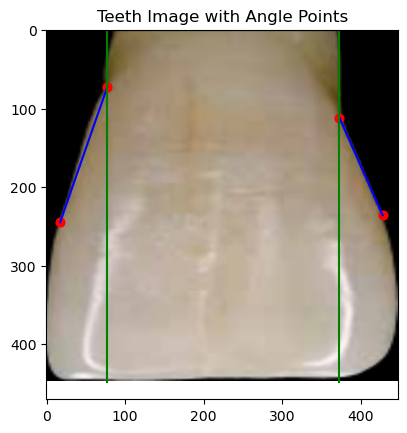

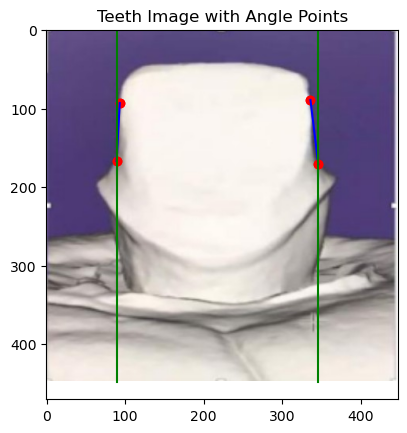

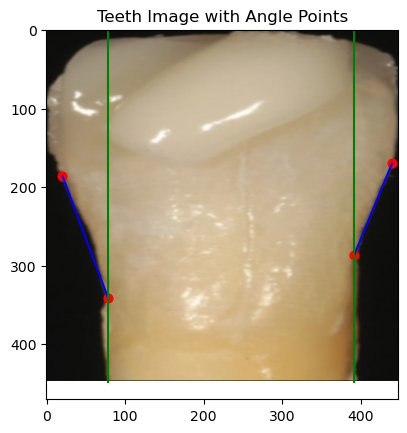

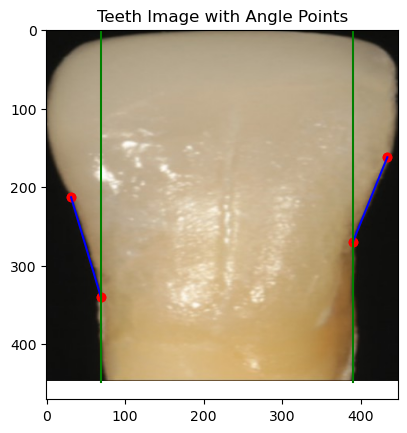

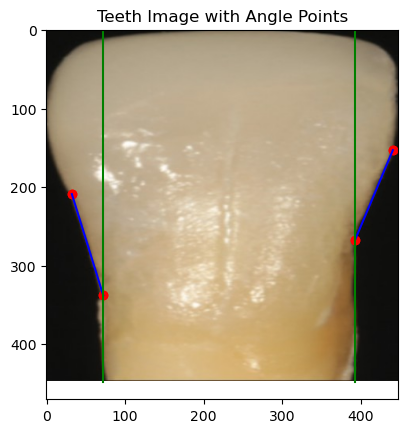

...

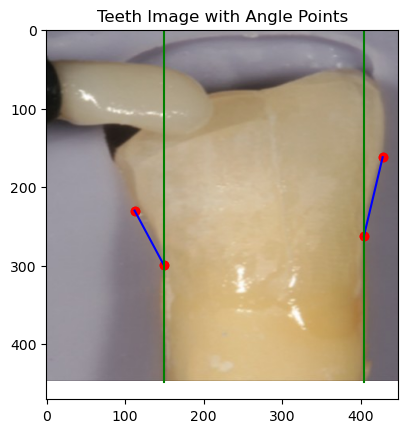

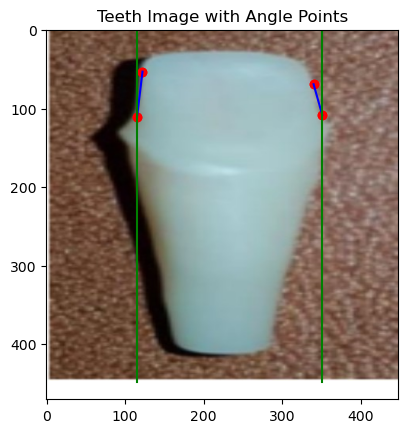

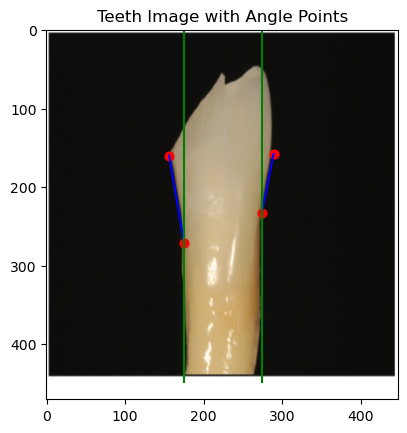

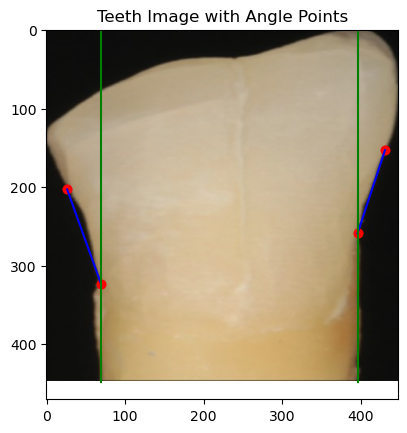

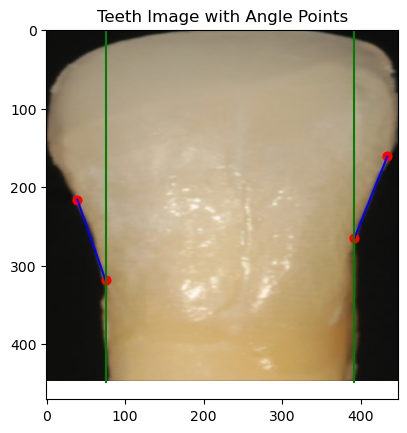

In [ ]:
import matplotlib.pyplot as plt
import cv2

image_paths = data_frame['Image']

# Visualiser les images et leurs points d'angle correspondants
for i in range(len(image_paths)):
    image = cv2.imread(image_paths[i])
    angles = [data_frame.loc[i, f'Coin_{x}'] for x in range(1, 5)]

    # Tracer l'image avec les points d'angle
    plt.figure()
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    for p in angles:
        plt.scatter([p[0], p[1]], [p[2], p[3]], color='red')  # Tracer les coordonnées x et y séparément
        # Tracer une ligne entre les deux points
        plt.plot()

    # Tracer des lignes entre les points d'angle
    for j in [0, 2]:
        x_coords = [angles[j][0], angles[j + 1][0]]  # Coordonnées x
        y_coords = [angles[j][2], angles[j + 1][2]]  # Coordonnées y
        x_c00rds = [angles[j][0], angles[j][0]]
        y_c00rds = [448, 0]
        plt.plot(x_coords, y_coords, color='blue')
        plt.plot(x_c00rds, y_c00rds, color='green')

    plt.title('Teeth Image with Angle Points')
    plt.show()

In [ ]:
import cv2
import numpy as np

images = data_frame['Image']
output_folder = _dir + '/masks'

# Définir le dossier de sortie pour enregistrer les images résultantes
os.makedirs(output_folder, exist_ok=True)

# Visualiser les images et leurs points d'angle correspondants
for i in range(len(images)):
    image = cv2.imread(images[i])
    mask = np.zeros_like(image)
    angles = [data_frame.loc[i, f'Coin_{x}'] for x in range(1, 5)]

    # Tracer des lignes entre les points d'angle
    for j in [0, 2]:
        x_coords = [angles[j][0], angles[j + 1][0]]  # Coordonnées x
        y_coords = [angles[j][2], angles[j + 1][2]]  # Coordonnées y
        cv2.line(mask, (x_coords[0], y_coords[0]), (x_coords[1], y_coords[1]), (255, 255, 255), 2)  # Dessiner des lignes bleues

    # Préparer le masque pour l'augmentation
    mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)  # Convertir le masque en niveaux de gris
    mask = np.expand_dims(mask, axis=-1)  # Ajouter la dimension du canal

    # Enregistrer l'image résultante
    output_path = os.path.join(output_folder, f'mask_{images[i][:-4]}.jpg')
    cv2.imwrite(output_path, mask)

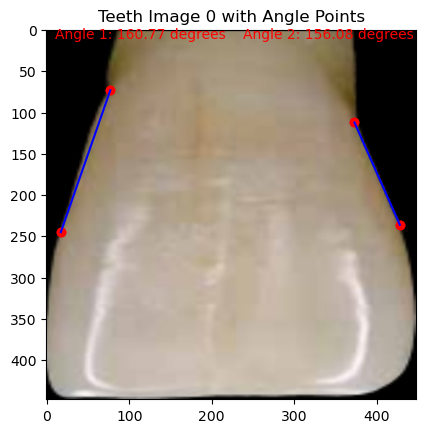

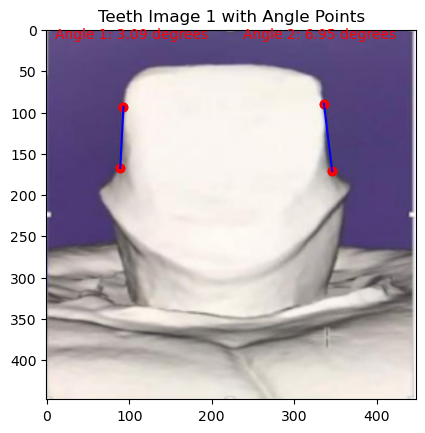

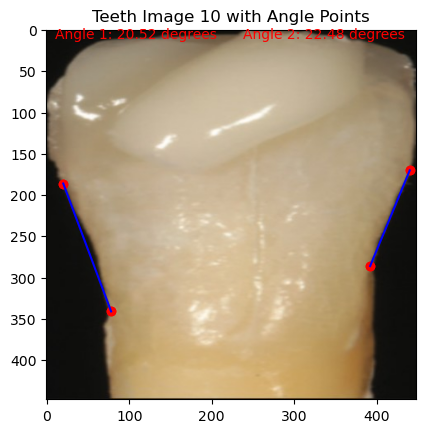

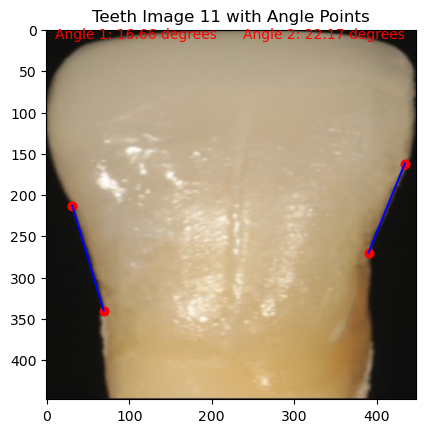

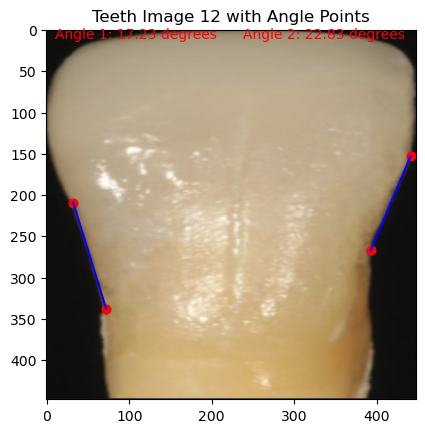

...

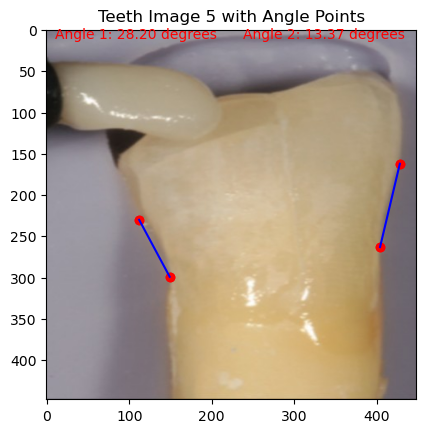

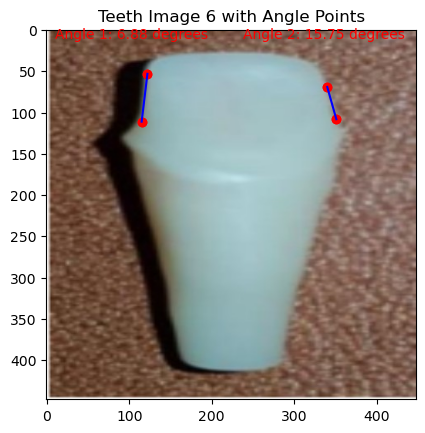

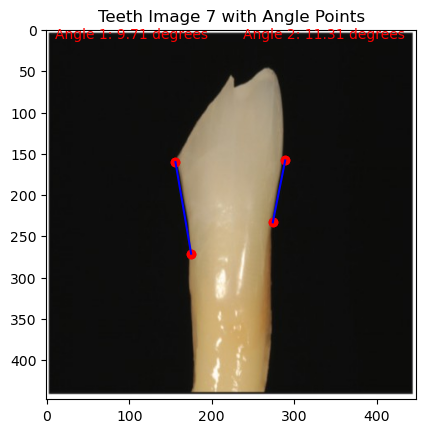

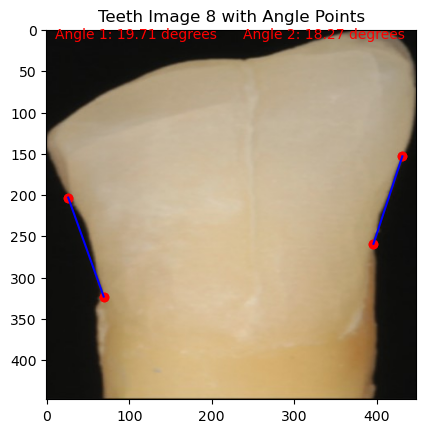

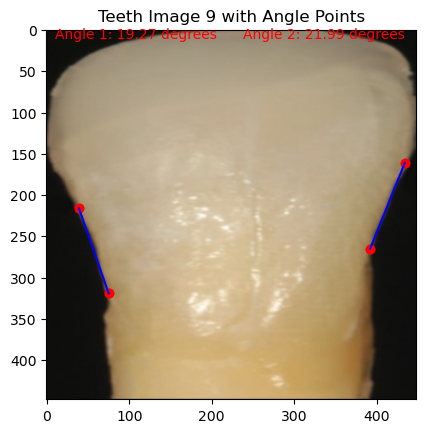

In [ ]:
import matplotlib.pyplot as plt
import cv2
import numpy as np

images = data_frame['Image']

# Visualiser les images et leurs points d'angle correspondants
for i in range(len(images)):
    image = cv2.imread(images[i])
    angles = [data_frame.loc[i, f'Coin_{x}'] for x in range(1, 5)]

    # Tracer l'image avec les points d'angle
    plt.figure()
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    # Tracer les points de dispersion
    for p in angles:
        plt.scatter([p[0], p[1]], [p[2], p[3]], color='red')

    angs = []

    # Tracer des lignes entre les points d'angle
    for j in [0, 2]:
        x_coords = [angles[j][0], angles[j + 1][0]]  # Coordonnées x
        y_coords = [angles[j][2], angles[j + 1][2]]  # Coordonnées y
        plt.plot(x_coords, y_coords, color='blue')

        # Calculer l'angle entre deux lignes
        # Définir les points de départ des deux lignes
        line1_start = np.array([angles[j][0], angles[j][2]])
        line2_start = np.array([angles[j+1][0], 448])

        # Définir les points d'arrêt des deux lignes
        line1_end = np.array([angles[j+1][0], angles[j+1][2]])
        line2_end = np.array([angles[j+1][0], 0])

        # Calculer les vecteurs de direction des deux lignes
        line1_vector = line1_end - line1_start
        line2_vector = line2_end - line2_start

        produit_scalaire = np.dot(line1_vector, line2_vector)
        produit_magnitude = np.linalg.norm(line1_vector) * np.linalg.norm(line2_vector)
        angle_rad = np.arccos(produit_scalaire / produit_magnitude)
        angle_deg = np.degrees(angle_rad)
        angs.append(angle_deg)

    plt.title(f'Teeth Image {images[i][:-4]} with Angle Points')
    plt.text(10, 10, f'Angle 1: {angs[0]:.2f} degrés', color='red') if angs[0] < 180 else  plt.text(10, 10, f'Angle: {angs[0]-360:.2f} degrés', color='red')
    plt.text(238, 10, f'Angle 2: {angs[1]:.2f} degrés', color='red') if angs[1] < 180 else  plt.text(10, 10, f'Angle: {angs[1]-360:.2f} degrés', color='red')
    plt.show()

In [ ]:
import cv2
import matplotlib.pyplot as plt

# Charger les images et les masques
images = []
masks = []

for im in data_frame['Image']:
    mask_path = f'masks/mask_{im[:-4]}.jpg'

    image = cv2.imread(im)
    mask = cv2.imread(mask_path)

    images.append(image)
    masks.append(mask)

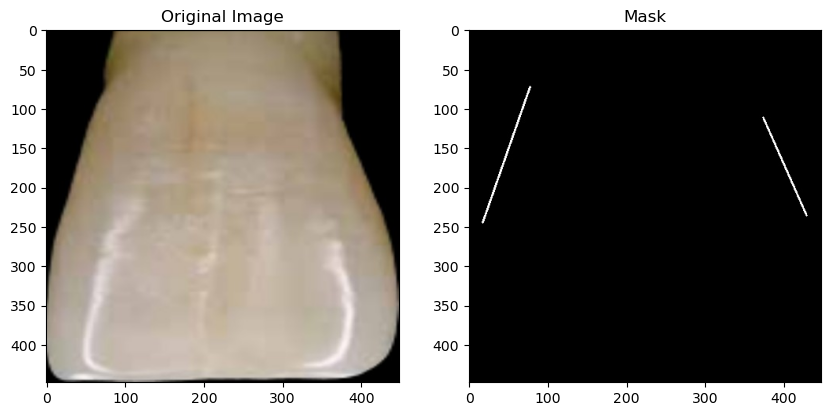

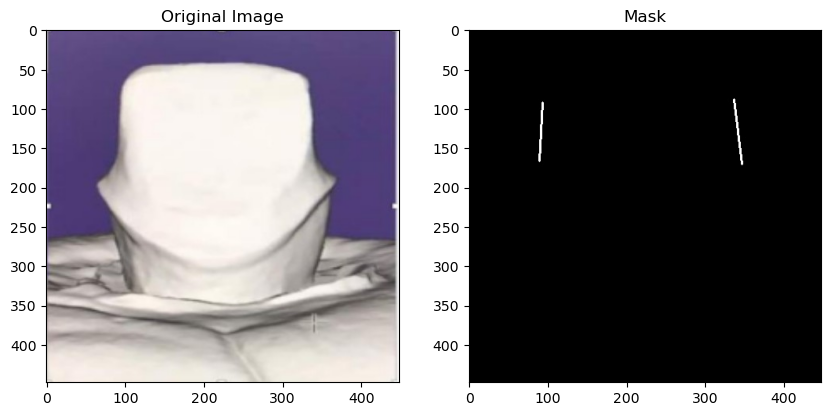

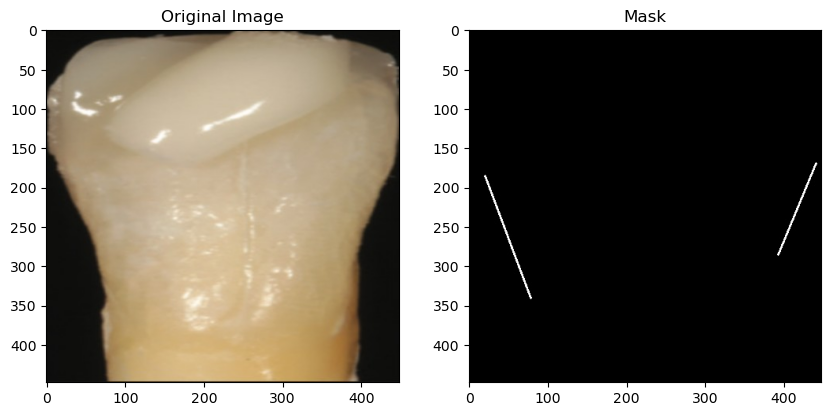

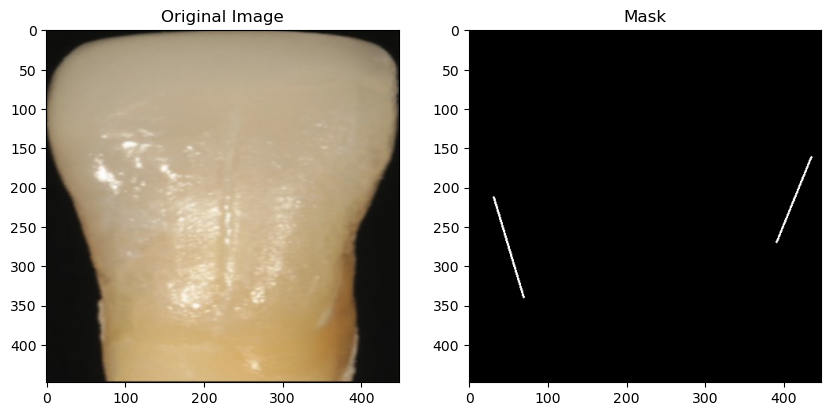

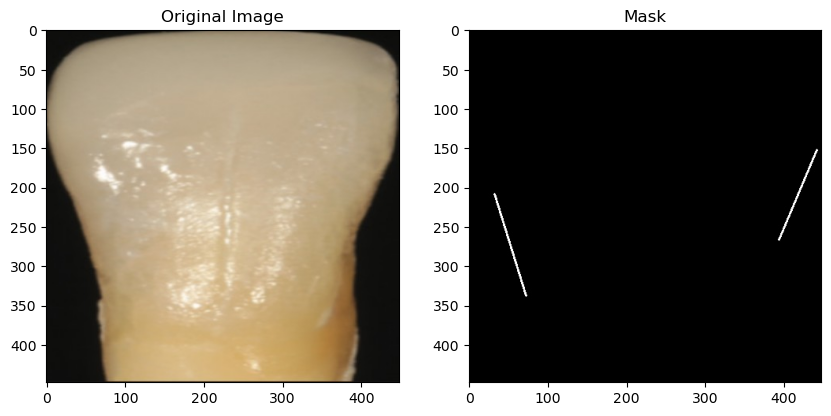

...

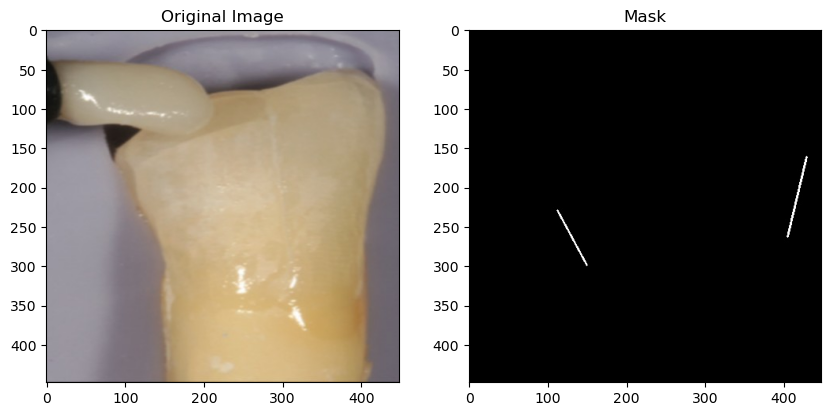

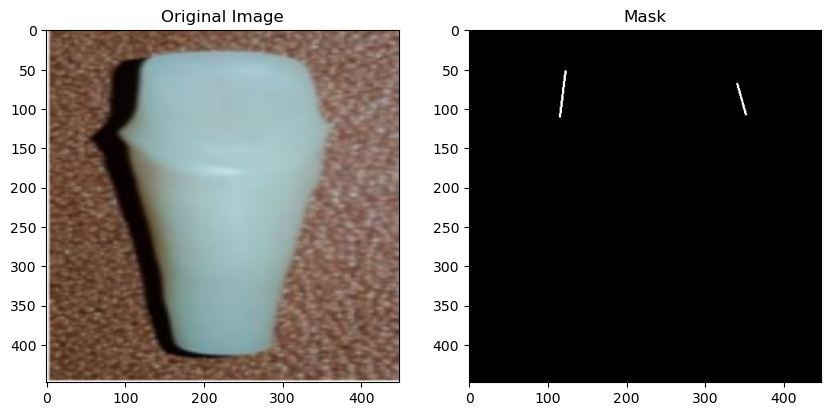

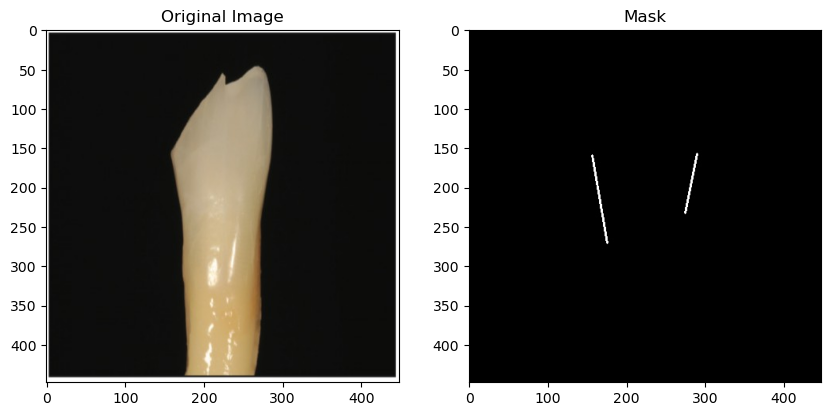

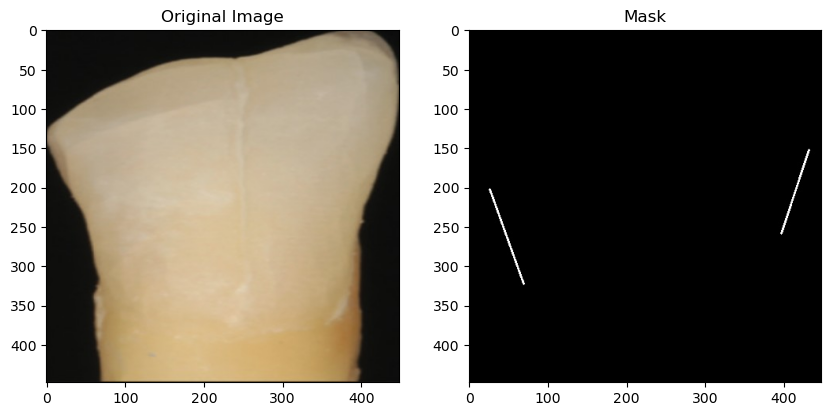

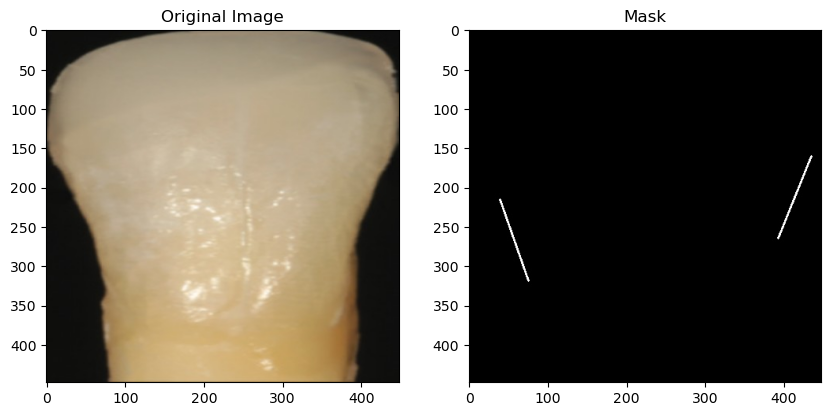

In [ ]:
# Afficher les images et les masques côte à côte
for image, mask in zip(images, masks):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # Afficher l'image originale
    axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Image originale')

    # Afficher le masque
    axes[1].imshow(mask, cmap='gray')
    axes[1].set_title('Masque')

    plt.show()

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Créer un générateur d'images avec les augmentations souhaitées
data_generator = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    horizontal_flip=True,
    vertical_flip=True,
    fill_mode='constant',
    cval=0
)

# Générer des images et des masques augmentés
images_augmentees = []
masks_augmentes = []

for image, mask in zip(images, masks):
    image_batch = np.expand_dims(image, axis=0)
    mask_batch = np.expand_dims(mask, axis=0)

    # Appliquer l'augmentation de données aux images
    batch_image_augmentee = data_generator.flow(image_batch, batch_size=1, shuffle=False)

    # Appliquer l'augmentation de données aux masques (utiliser la même graine pour la cohérence)
    batch_mask_augmente = data_generator.flow(mask_batch, batch_size=1, shuffle=False)

    image_augmentee = next(batch_image_augmentee)[0]
    mask_augmente = next(batch_mask_augmente)[0]

    images_augmentees.append(image_augmentee)
    masks_augmentes.append(mask_augmente)

images_augmentees = np.array(images_augmentees)
masks_augmentes = np.array(masks_augmentes)

# Vérifier les formes des images et des masques augmentés
print(f'Taille des images augmentées : {images_augmentees.size}, Forme : {images_augmentees.shape}')
print(f'Taille des masques augmentés : {masks_augmentes.size}, Forme : {masks_augmentes.shape}')

Augmented Images Size : 28901376, Shape : (48, 448, 448, 3)
Augmented Masks Size : 28901376, Shape : (48, 448, 448, 3)


In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate

def build_unet(input_shape):
    inputs = Input(input_shape)

    # Encodeur
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    # Décodeur
    up2 = UpSampling2D(size=(2, 2))(pool1)
    up2 = Conv2D(64, 2, activation='relu', padding='same')(up2)
    merge2 = concatenate([conv1, up2], axis=3)
    conv2 = Conv2D(64, 3, activation='relu', padding='same')(merge2)
    conv2 = Conv2D(64, 3, activation='relu', padding='same')(conv2)

    outputs = Conv2D(1, 1, activation='sigmoid')(conv2)

    model = Model(inputs=inputs, outputs=outputs)
    return model

# Construire le modèle U-Net
input_shape = images[0].shape
model = build_unet(input_shape)

# Modifier les masques pour avoir un seul canal
masks_augmentes_mono_canal = augmented_masks[..., 0:1]

# Compiler le modèle
model.compile(optimizer='adam', loss='binary_crossentropy')

# Entraîner le modèle
model.fit(augmented_images, masks_augmentes_mono_canal, batch_size=8, epochs=10, validation_split=0.2)

Epoch 1/10
5/5 [==============================] - 434s 83s/step - loss: 8.1781 - val_loss: 4.4443
Epoch 2/10
5/5 [==============================] - 381s 76s/step - loss: 2.4653 - val_loss: 3.3567
Epoch 3/10
5/5 [==============================] - 379s 77s/step - loss: 1.5102 - val_loss: 1.1518
Epoch 4/10
5/5 [==============================] - 390s 79s/step - loss: 0.7155 - val_loss: 0.9183
Epoch 5/10
5/5 [==============================] - 384s 75s/step - loss: 0.6190 - val_loss: 0.7720
Epoch 6/10
5/5 [==============================] - 372s 74s/step - loss: 0.4876 - val_loss: 1.1563
Epoch 7/10
5/5 [==============================] - 379s 76s/step - loss: 0.2955 - val_loss: 1.4839
Epoch 8/10
5/5 [==============================] - 376s 75s/step - loss: -0.0531 - val_loss: 2.0707
Epoch 9/10
5/5 [==============================] - 378s 75s/step - loss: -1.3355 - val_loss: 4.5477
Epoch 10/10
5/5 [==============================] - 367s 74s/step - loss: -4.3945 - val_loss: 8.2508


In [ ]:
# Effectuer des prédictions sur de nouvelles images
nouveau_chemin_image = '23.jpg'
nouvelle_image = cv2.imread(nouveau_chemin_image)

# Prétraiter la nouvelle image
nouvelle_image = np.expand_dims(nouvelle_image, axis=0)

# Prédire le masque de ligne
masque_ligne = model.predict(nouvelle_image)

# Seuiller le masque de ligne
seuil = 0.5
masque_seuil = (masque_ligne > seuil).astype(np.uint8)

# Effectuer un post-traitement si nécessaire (par exemple, opérations morphologiques ou ajustement de ligne)

# Visualiser le masque de ligne
cv2.imshow("Masque de ligne", masque_seuil[0] * 255)
cv2.waitKey(0)
cv2.destroyAllWindows()

1/1 [==============================] - 1s 794ms/step


In [ ]:
from sklearn.model_selection import train_test_split

# Modifier les masques pour avoir un seul canal
masques_augmentes_canal_unique = augmented_masks[..., 0:1]
# Diviser les données augmentées en ensembles d'entraînement et de validation
images_entrainement, images_validation, masques_entrainement, masques_validation = train_test_split(augmented_images, masques_augmentes_canal_unique, test_size=0.2, random_state=42)

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Concatenate

def modele_unet(forme_entree):
    entrees = Input(forme_entree)

    # Chemin d'encodage
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(entrees)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    # Ajoutez d'autres couches de convolution et de regroupement selon les besoins

    # Chemin de décodage
    up6 = UpSampling2D(size=(2, 2))(pool1)
    fusion6 = Concatenate(axis=3)([conv1, up6])
    conv6 = Conv2D(2, 3, activation='relu', padding='same')(fusion6)
    # Ajoutez d'autres couches de suréchantillonnage et de concaténation selon les besoins

    # Sortie
    sorties = Conv2D(1, 1, activation='sigmoid')(conv6)

    modele = Model(inputs=entrees, outputs=sorties)
    return modele


# Construire le modèle U-Net
forme_entree = images[0].shape
modele = modele_unet(forme_entree)

In [ ]:
# Construire le modèle U-Net
forme_entree = images[0].shape
modele = modele_unet(forme_entree)

In [ ]:
# Compiler le modèle
modele.compile(optimizer='adam', loss='binary_crossentropy')
# Entraîner le modèle
modele.fit(train_images, train_masks, batch_size=8, epochs=10, validation_data=(val_images, val_masks))

Epoch 1/10
5/5 [==============================] - 800s 156s/step - loss: 13.7868 - val_loss: 4.4972
Epoch 2/10
5/5 [==============================] - 768s 153s/step - loss: 2.0566 - val_loss: 0.8689
Epoch 3/10
5/5 [==============================] - 747s 150s/step - loss: 0.7223 - val_loss: 0.6419
Epoch 4/10
5/5 [==============================] - 733s 146s/step - loss: 0.7820 - val_loss: 0.7556
Epoch 5/10
5/5 [==============================] - 730s 147s/step - loss: 0.6069 - val_loss: 0.5682
Epoch 6/10
5/5 [==============================] - 725s 146s/step - loss: 0.5923 - val_loss: 0.2698
Epoch 7/10
5/5 [==============================] - 751s 151s/step - loss: 0.3215 - val_loss: -1.2952
Epoch 8/10
5/5 [==============================] - 743s 150s/step - loss: -10.8067 - val_loss: -54.4595
Epoch 9/10
5/5 [==============================] - 745s 148s/step - loss: 256.2889 - val_loss: -21.6816
Epoch 10/10
5/5 [==============================] - 738s 148s/step - loss: -21.5572 - val_loss: -31.

In [ ]:
# Évaluer le modèle
eval_loss = modele.evaluate(val_images, val_masks)
print("Evaluation Loss :", eval_loss)

1/1 [==============================] - 40s 40s/step - loss: -31.2829
Evaluation Loss: -31.282934188842773


In [ ]:
# Effectuer une inférence sur de nouvelles images
nouveau_chemin_image = '3.jpg'
nouvelle_image = cv2.imread(nouveau_chemin_image)

# Prétraiter la nouvelle image
nouvelle_image = np.expand_dims(nouvelle_image, axis=0)

# Prédire le masque de ligne
masque_ligne = modele.predict(nouvelle_image)

# Appliquer un seuillage sur le masque de ligne
seuil = 0.5
masque_seuille = (masque_ligne > seuil).astype(np.uint8)

# Visualiser le masque de ligne
cv2.imshow("Masque de ligne", masque_seuille[0] * 255)
cv2.waitKey(0)
cv2.destroyAllWindows()

1/1 [==============================] - 4s 4s/step


In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Dropout, UpSampling2D, Concatenate, Activation

def modele_unet_3(forme_entree):
    # Encodeur
    entrees = Input(shape=forme_entree)
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(entrees)
    conv1 = Conv2D(64, 3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    # Milieu
    conv3 = Conv2D(256, 3, activation='relu', padding='same')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same')(conv3)

    # Décodeur
    up4 = UpSampling2D(size=(2, 2))(conv3)
    up4 = Conv2D(128, 2, activation='relu', padding='same')(up4)
    concat4 = Concatenate(axis=-1)([conv2, up4])
    conv4 = Conv2D(128, 3, activation='relu', padding='same')(concat4)
    conv4 = Conv2D(128, 3, activation='relu', padding='same')(conv4)

    up5 = UpSampling2D(size=(2, 2))(conv4)
    up5 = Conv2D(64, 2, activation='relu', padding='same')(up5)
    concat5 = Concatenate(axis=-1)([conv1, up5])
    conv5 = Conv2D(64, 3, activation='relu', padding='same')(concat5)
    conv5 = Conv2D(64, 3, activation='relu', padding='same')(conv5)

    # Couche de sortie pour le masque avec deux lignes droites
    canaux_sortie = 1  # Nombre de canaux dans le masque de sortie
    activation_sortie = 'sigmoid'  # Fonction d'activation pour le masque de sortie
    couche_sortie = Conv2D(canaux_sortie, (1, 1))(conv5)
    couche_sortie = Activation(activation_sortie)(couche_sortie)

    # Créer le modèle
    modele = Model(inputs=entrees, outputs=couche_sortie)

    return modele